In [4]:
%load_ext autoreload
%autoreload 2


In [5]:
import pandas as pd
import pickle as pkl
import os
from os.path import join
import glob
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
import torch.optim as optim

In [2]:
subject_id = "paul_20250428-20250430"
subject_id = "red_20250428-20250430"

In [3]:
posthoc_dir = f"/n/holylabs/LABS/alvarez_lab/Lab/VVS_Accentuation/Encoding_models/{subject_id}/posthoc_model_predict"
os.makedirs(posthoc_dir, exist_ok=True)
df_acc_w_pred_resp = pd.read_pickle(join(posthoc_dir, f"accentuated_stim_info_w_pred_resp_{subject_id}.pkl"))
pred_resp_dict = pkl.load(open(join(posthoc_dir, f"pred_resp_dict_{subject_id}.pkl"), "rb"))
df_accentuated = pd.read_pickle(join(posthoc_dir, f"accentuated_stim_info_{subject_id}.pkl"))

In [6]:
list(df_acc_w_pred_resp)

['model_name',
 'unit_id',
 'img_id',
 'level',
 'score',
 'filepath',
 'pred_resp_AlexNet_training_seed_01_unit_0',
 'pred_resp_AlexNet_training_seed_01_unit_15',
 'pred_resp_AlexNet_training_seed_01_unit_19',
 'pred_resp_AlexNet_training_seed_01_unit_2',
 'pred_resp_AlexNet_training_seed_01_unit_9',
 'pred_resp_clipag_vitb32_unit_0',
 'pred_resp_clipag_vitb32_unit_15',
 'pred_resp_clipag_vitb32_unit_19',
 'pred_resp_clipag_vitb32_unit_2',
 'pred_resp_clipag_vitb32_unit_9',
 'pred_resp_dinov2_vitb14_reg_unit_0',
 'pred_resp_dinov2_vitb14_reg_unit_15',
 'pred_resp_dinov2_vitb14_reg_unit_19',
 'pred_resp_dinov2_vitb14_reg_unit_2',
 'pred_resp_dinov2_vitb14_reg_unit_9',
 'pred_resp_radio_v2.5-b_unit_0',
 'pred_resp_radio_v2.5-b_unit_15',
 'pred_resp_radio_v2.5-b_unit_19',
 'pred_resp_radio_v2.5-b_unit_2',
 'pred_resp_radio_v2.5-b_unit_9',
 'pred_resp_regnety_640_unit_0',
 'pred_resp_regnety_640_unit_15',
 'pred_resp_regnety_640_unit_19',
 'pred_resp_regnety_640_unit_2',
 'pred_resp_regne

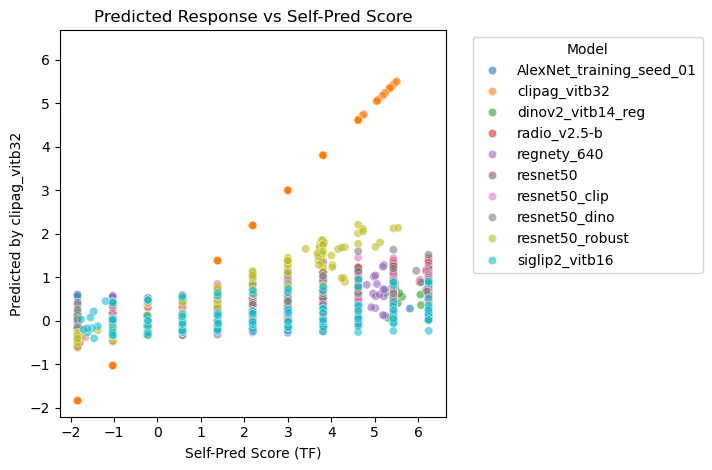

In [13]:
review_model_name = "clipag_vitb32"
sns.scatterplot(data=df_acc_w_pred_resp.query("unit_id == 0"), x="score", 
                y=f'pred_resp_{review_model_name}_unit_0', hue="model_name", palette="tab10", alpha=0.6)
plt.axis('square')
plt.xlabel("Self-Pred Score (TF)")
plt.ylabel(f"Predicted by {review_model_name}")
plt.title("Predicted Response vs Self-Pred Score")
plt.legend(title="Model", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

In [18]:
list(df_acc_w_pred_resp)

['model_name',
 'unit_id',
 'img_id',
 'level',
 'score',
 'filepath',
 'pred_resp_AlexNet_training_seed_01_unit_0',
 'pred_resp_AlexNet_training_seed_01_unit_15',
 'pred_resp_AlexNet_training_seed_01_unit_19',
 'pred_resp_AlexNet_training_seed_01_unit_2',
 'pred_resp_AlexNet_training_seed_01_unit_9',
 'pred_resp_clipag_vitb32_unit_0',
 'pred_resp_clipag_vitb32_unit_15',
 'pred_resp_clipag_vitb32_unit_19',
 'pred_resp_clipag_vitb32_unit_2',
 'pred_resp_clipag_vitb32_unit_9',
 'pred_resp_dinov2_vitb14_reg_unit_0',
 'pred_resp_dinov2_vitb14_reg_unit_15',
 'pred_resp_dinov2_vitb14_reg_unit_19',
 'pred_resp_dinov2_vitb14_reg_unit_2',
 'pred_resp_dinov2_vitb14_reg_unit_9',
 'pred_resp_radio_v2.5-b_unit_0',
 'pred_resp_radio_v2.5-b_unit_15',
 'pred_resp_radio_v2.5-b_unit_19',
 'pred_resp_radio_v2.5-b_unit_2',
 'pred_resp_radio_v2.5-b_unit_9',
 'pred_resp_regnety_640_unit_0',
 'pred_resp_regnety_640_unit_15',
 'pred_resp_regnety_640_unit_19',
 'pred_resp_regnety_640_unit_2',
 'pred_resp_regne

In [33]:
model_names

array(['AlexNet_training_seed_01', 'clipag_vitb32', 'dinov2_vitb14_reg',
       'radio_v2.5-b', 'regnety_640', 'resnet50', 'resnet50_clip',
       'resnet50_dino', 'resnet50_robust', 'siglip2_vitb16'], dtype=object)

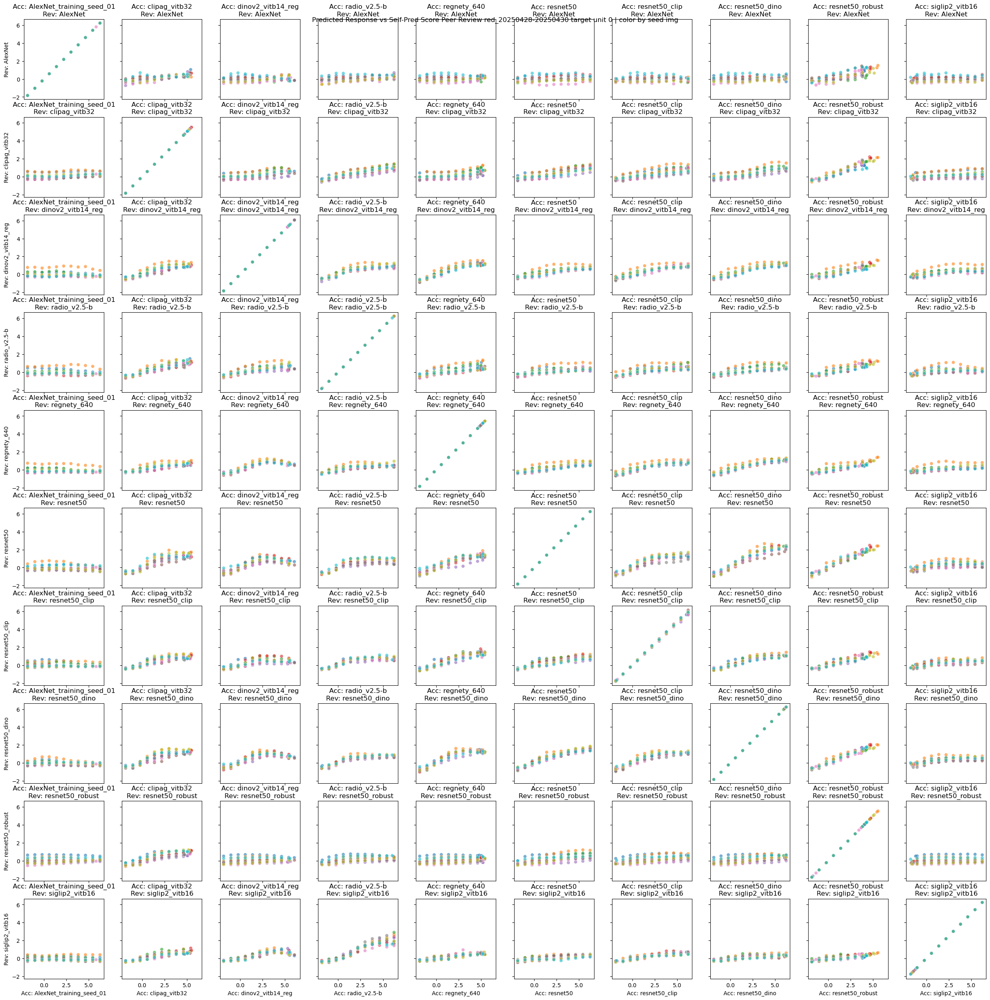

In [30]:
unit_id = 0
figh, axs = plt.subplots(10, 10, figsize=(25, 25), sharex=True, sharey=True)
model_names = df_acc_w_pred_resp['model_name'].unique()
for rowi, model_name_rev in enumerate(model_names):
    for coli, model_name_acc in enumerate(model_names):
        sns.scatterplot(data=df_acc_w_pred_resp.query("model_name == @model_name_acc and unit_id == @unit_id"), 
                        x="score", y=f'pred_resp_{model_name_rev}_unit_{unit_id}', 
                        hue="img_id", palette="tab10", alpha=0.6, ax=axs[rowi, coli], legend=False)
        model_name_rev_abv = model_name_rev.replace("AlexNet_training_seed_01", "AlexNet")
        model_name_acc_abv = model_name_acc.replace("AlexNet_training_seed_02", "AlexNet")
        axs[rowi, coli].set_xlabel(f"Acc: {model_name_acc_abv}")
        axs[rowi, coli].set_ylabel(f"Rev: {model_name_rev_abv}")
        axs[rowi, coli].axis('square')
        axs[rowi, coli].set_title(f"Acc: {model_name_acc_abv}\nRev: {model_name_rev_abv}")
plt.suptitle(f"Predicted Response vs Self-Pred Score Peer Review {subject_id} target unit {unit_id} | color by seed img")
plt.tight_layout(pad=0.05)
plt.show()

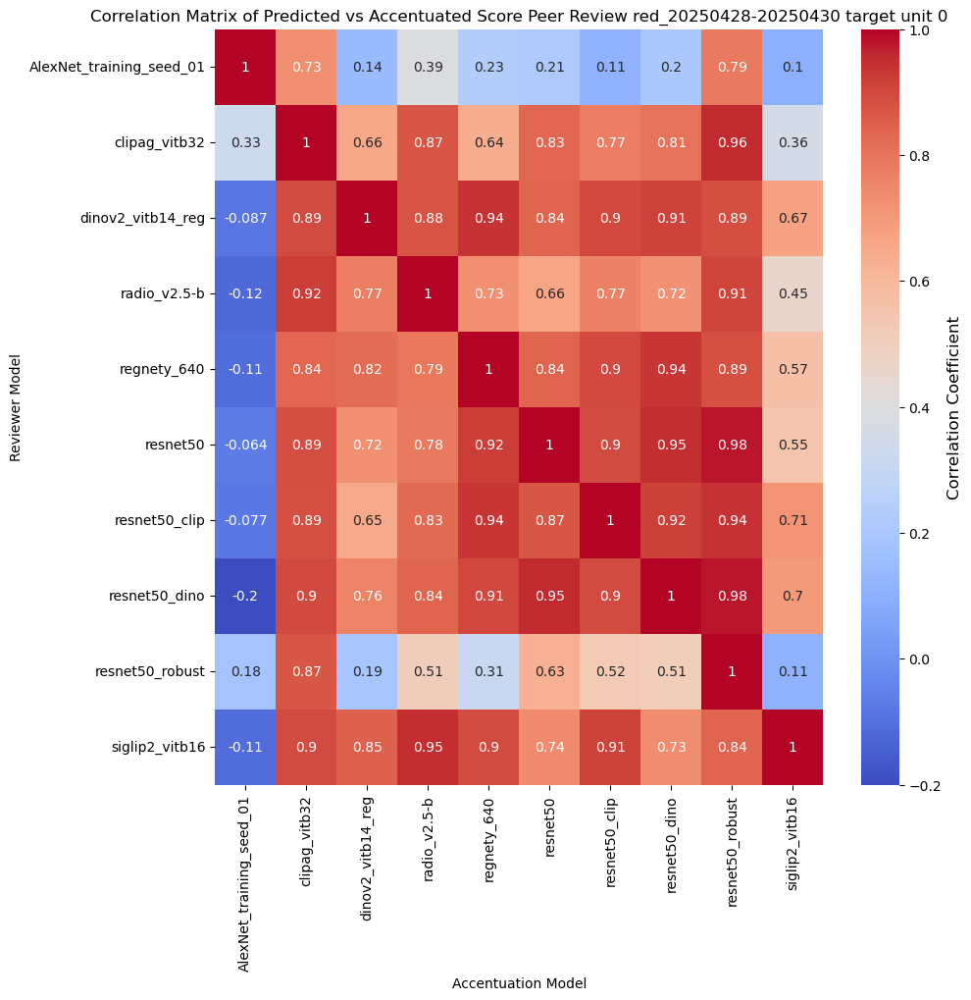

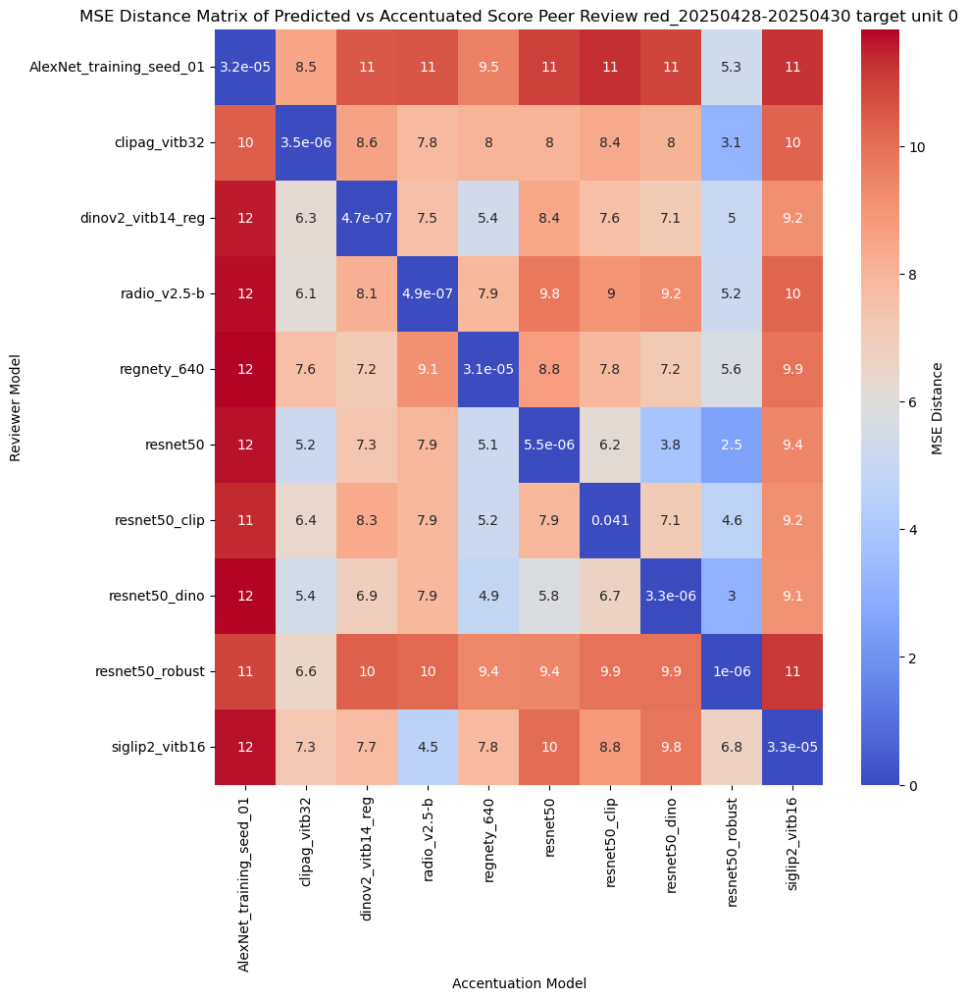

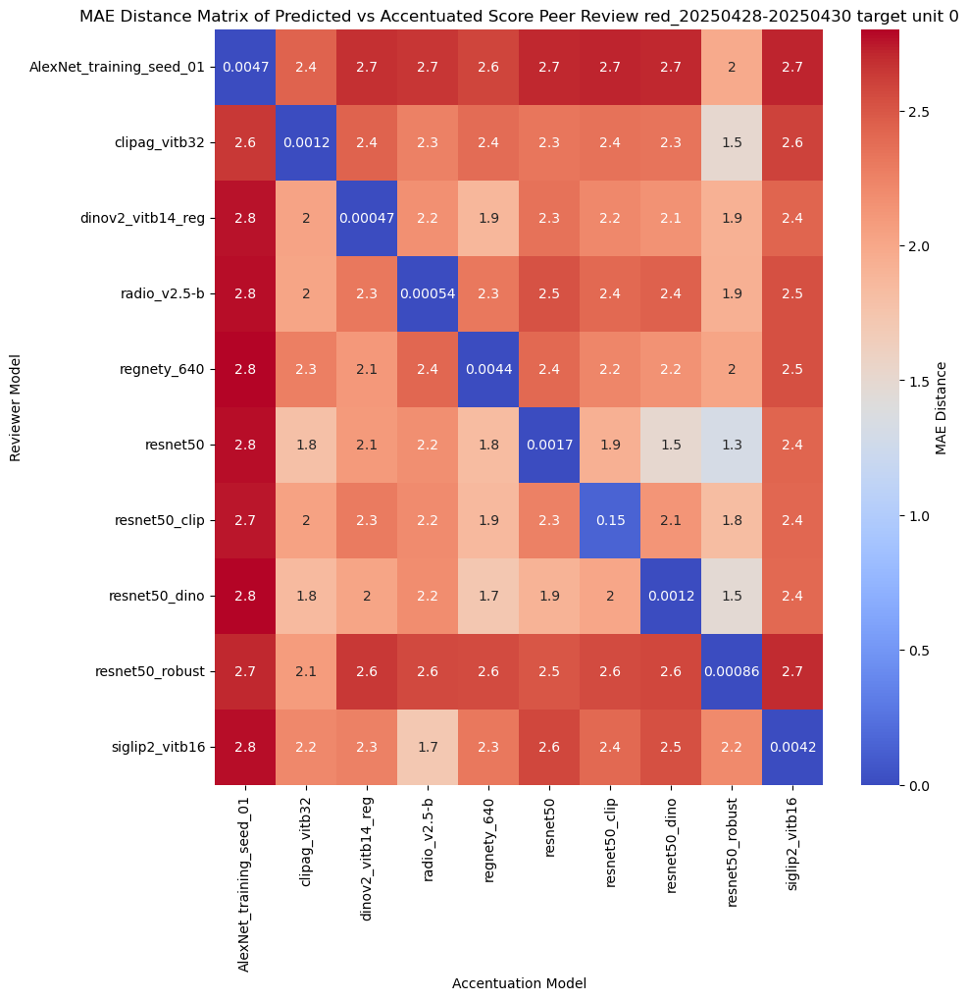

In [32]:
from scipy.stats import pearsonr
# figh, axs = plt.subplots(10, 10, figsize=(25, 25), sharex=True, sharey=True)
# model_names = df_acc_w_pred_resp['model_name'].unique()
corr_coef_mat = np.zeros((len(model_names), len(model_names)))
MSE_dist_mat = np.zeros((len(model_names), len(model_names)))
MAE_dist_mat = np.zeros((len(model_names), len(model_names)))
for rowi, model_name_rev in enumerate(model_names):
    for coli, model_name_acc in enumerate(model_names):
        part_df = df_acc_w_pred_resp.query("model_name == @model_name_acc and unit_id == 0")
        MSE_dist = np.mean((part_df["score"] - part_df[f'pred_resp_{model_name_rev}_unit_0']) ** 2)
        MSE_dist_mat[rowi, coli] = MSE_dist
        corr_coef, _ = pearsonr(part_df["score"], part_df[f'pred_resp_{model_name_rev}_unit_0'])
        corr_coef_mat[rowi, coli] = corr_coef
        MAE_dist = np.mean(np.abs(part_df["score"] - part_df[f'pred_resp_{model_name_rev}_unit_0']))
        MAE_dist_mat[rowi, coli] = MAE_dist

plt.figure(figsize=(10, 10))
# Create the heatmap and store the returned mappable object
hm = sns.heatmap(corr_coef_mat, annot=True, cmap="coolwarm", vmin=-0.2, vmax=1, xticklabels=model_names, yticklabels=model_names)
plt.title(f"Correlation Matrix of Predicted vs Accentuated Score Peer Review {subject_id} target unit {unit_id}")
plt.ylabel("Reviewer Model")
plt.xlabel("Accentuation Model")
# Get the colorbar from the heatmap and set its label
cbar = hm.collections[0].colorbar
cbar.set_label("Correlation Coefficient", fontsize=12)
plt.show()

plt.figure(figsize=(10, 10))
hm = sns.heatmap(MSE_dist_mat, annot=True, cmap="coolwarm", vmin=0, vmax=None, xticklabels=model_names, yticklabels=model_names)
plt.title(f"MSE Distance Matrix of Predicted vs Accentuated Score Peer Review {subject_id} target unit {unit_id}")
plt.ylabel("Reviewer Model")
plt.xlabel("Accentuation Model")
# colorbar title
cbar = hm.collections[0].colorbar
cbar.set_label("MSE Distance")
plt.show()

plt.figure(figsize=(10, 10))
hm = sns.heatmap(MAE_dist_mat, annot=True, cmap="coolwarm", vmin=0, vmax=None, xticklabels=model_names, yticklabels=model_names)
plt.title(f"MAE Distance Matrix of Predicted vs Accentuated Score Peer Review {subject_id} target unit {unit_id}")
plt.ylabel("Reviewer Model")
plt.xlabel("Accentuation Model")
# colorbar title
cbar = hm.collections[0].colorbar
cbar.set_label("MAE Distance")
plt.show()


### Mass produce of peer review images

In [35]:
from circuit_toolkit.plot_utils import saveallforms

In [37]:
model_names = ['clipag_vitb32', 'dinov2_vitb14_reg', 'siglip2_vitb16', 'radio_v2.5-b', 
                'resnet50', 'resnet50_robust', 'resnet50_dino', 'resnet50_clip',
                'regnety_640', 'AlexNet_training_seed_01', ]

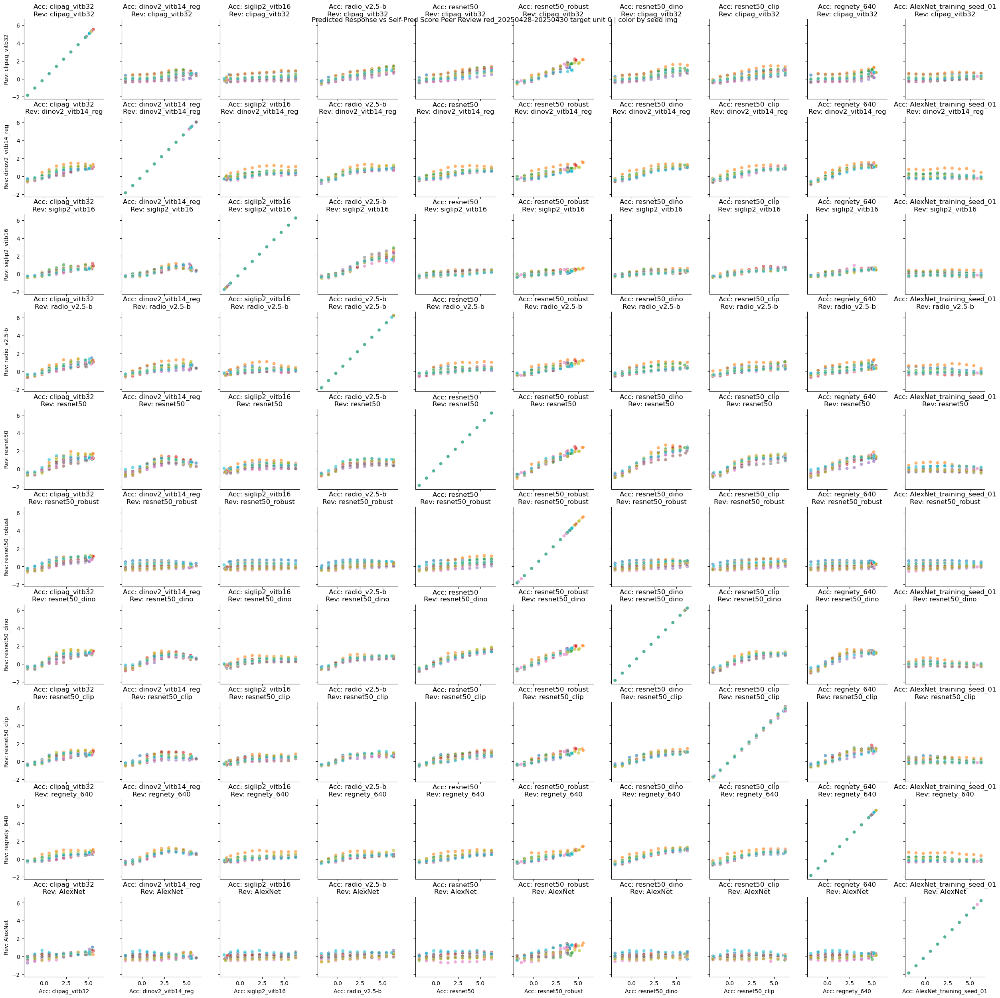

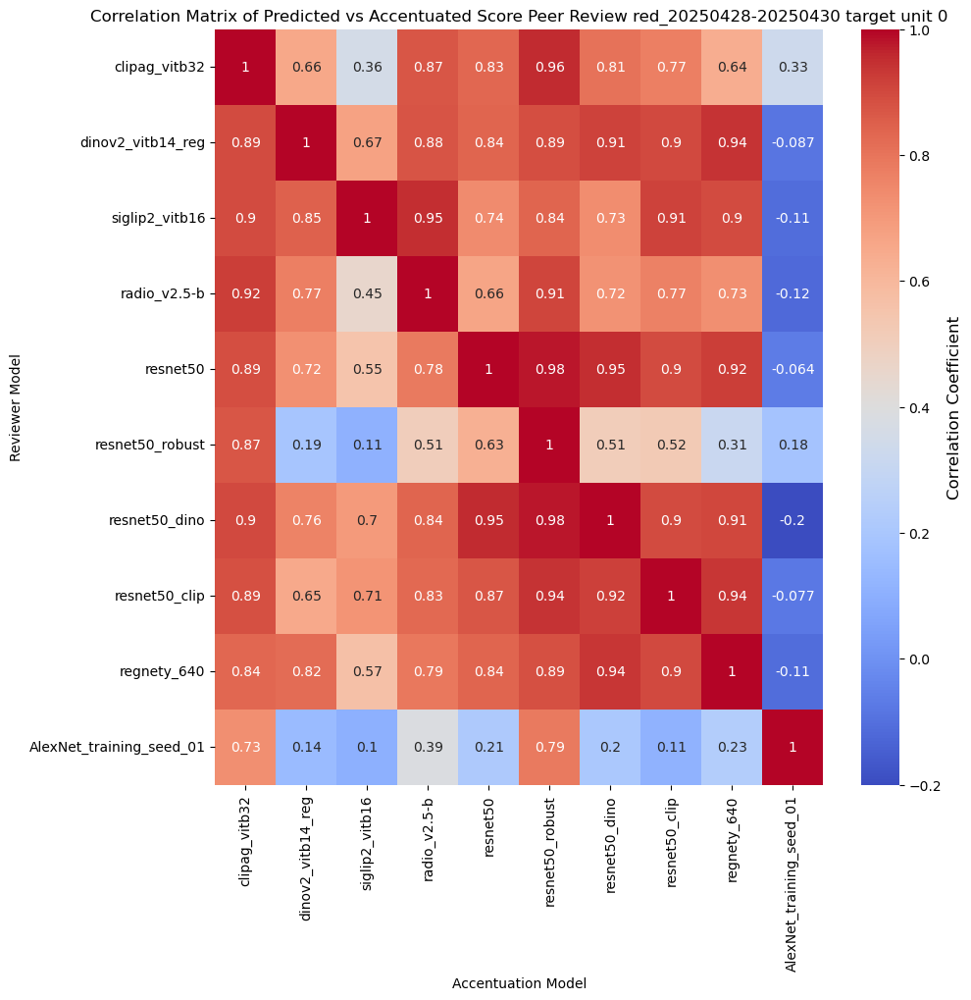

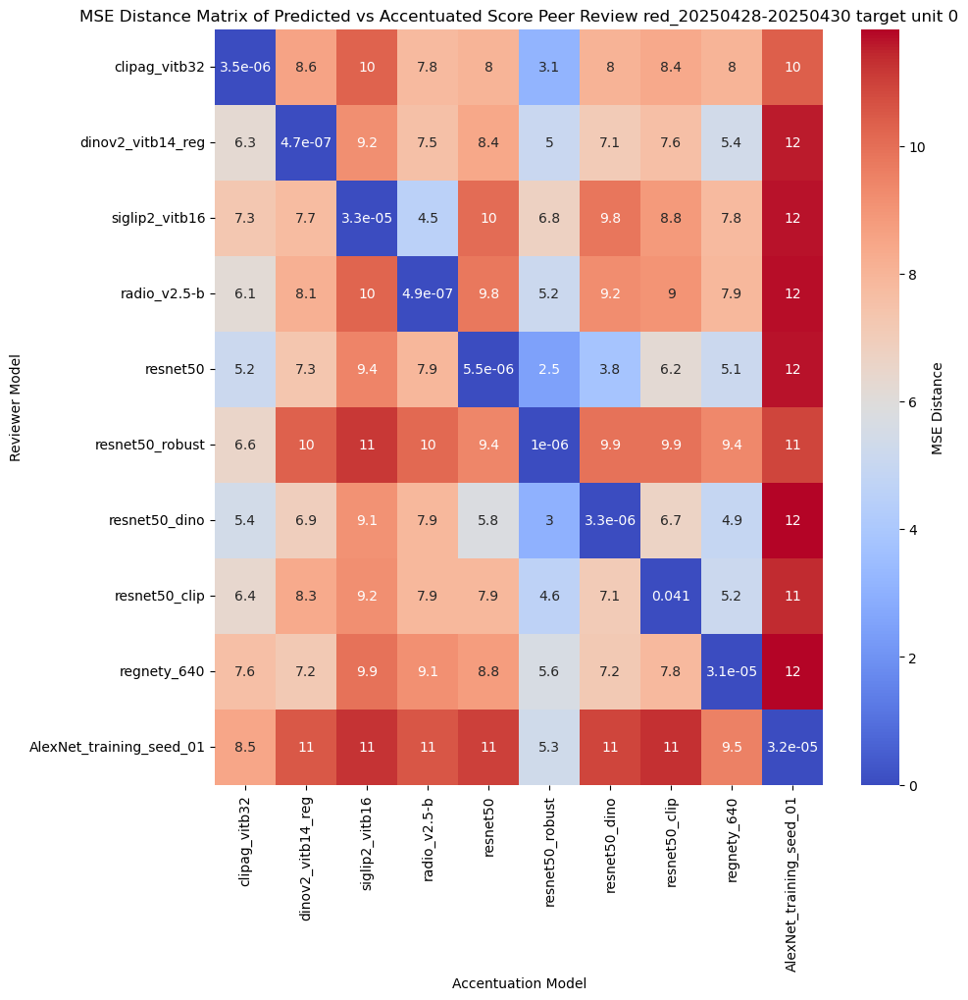

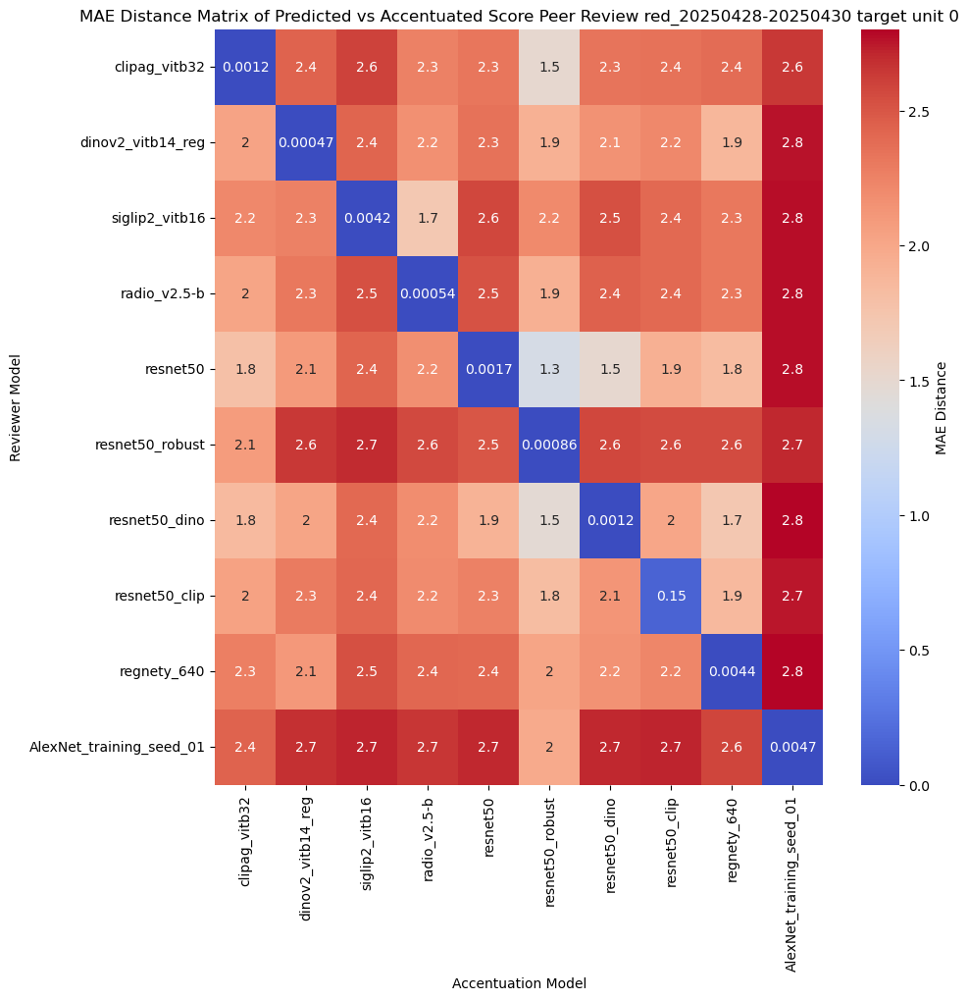

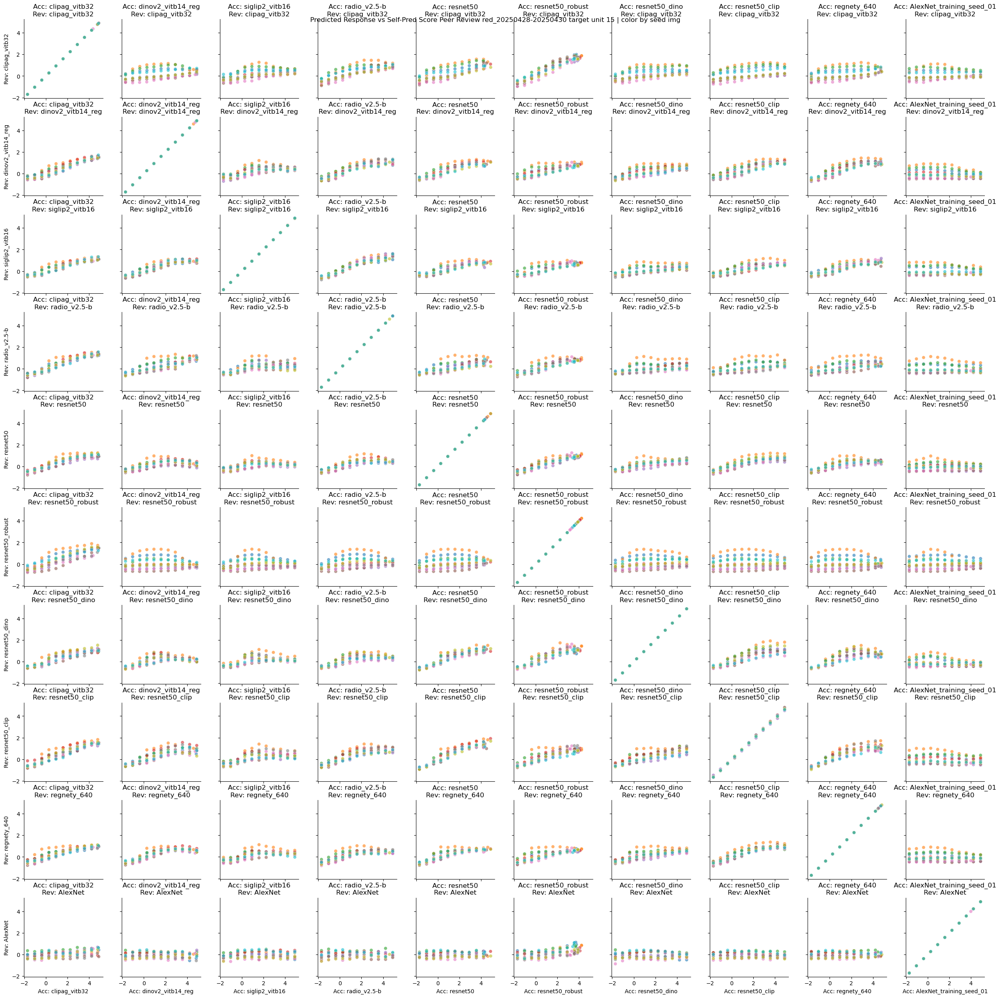

...

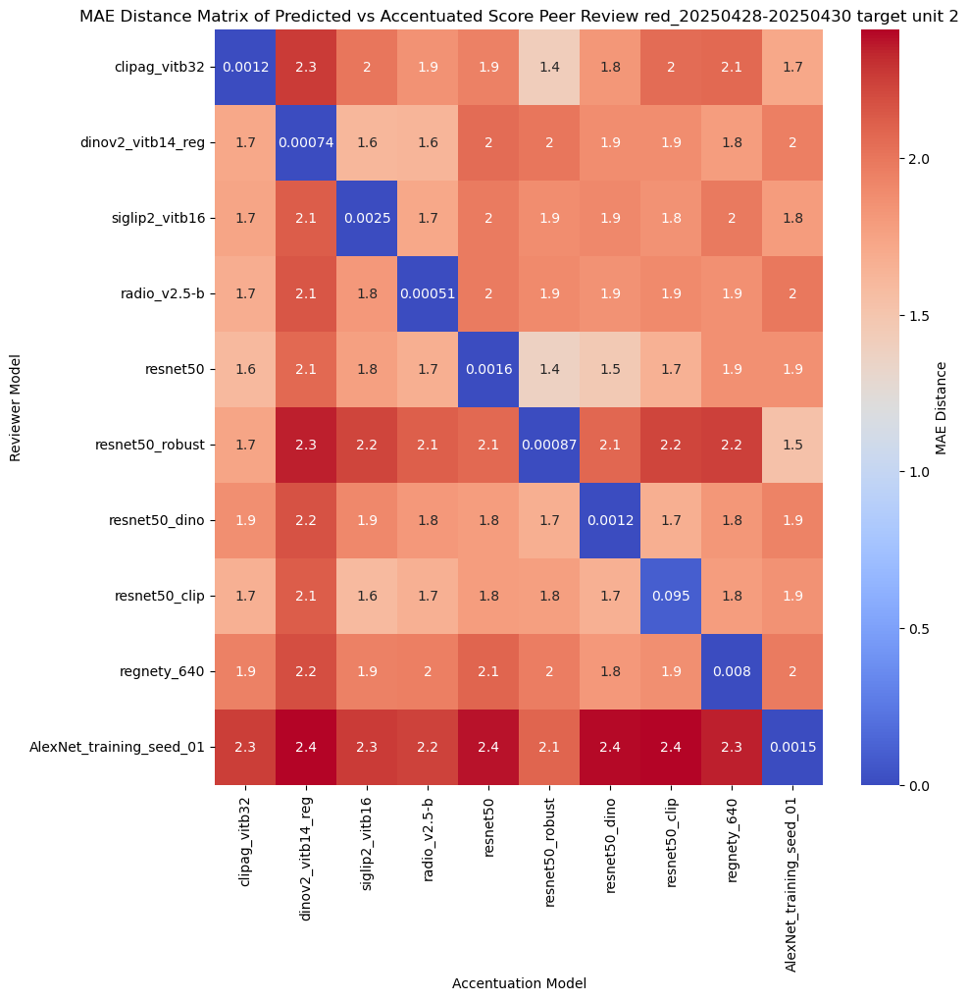

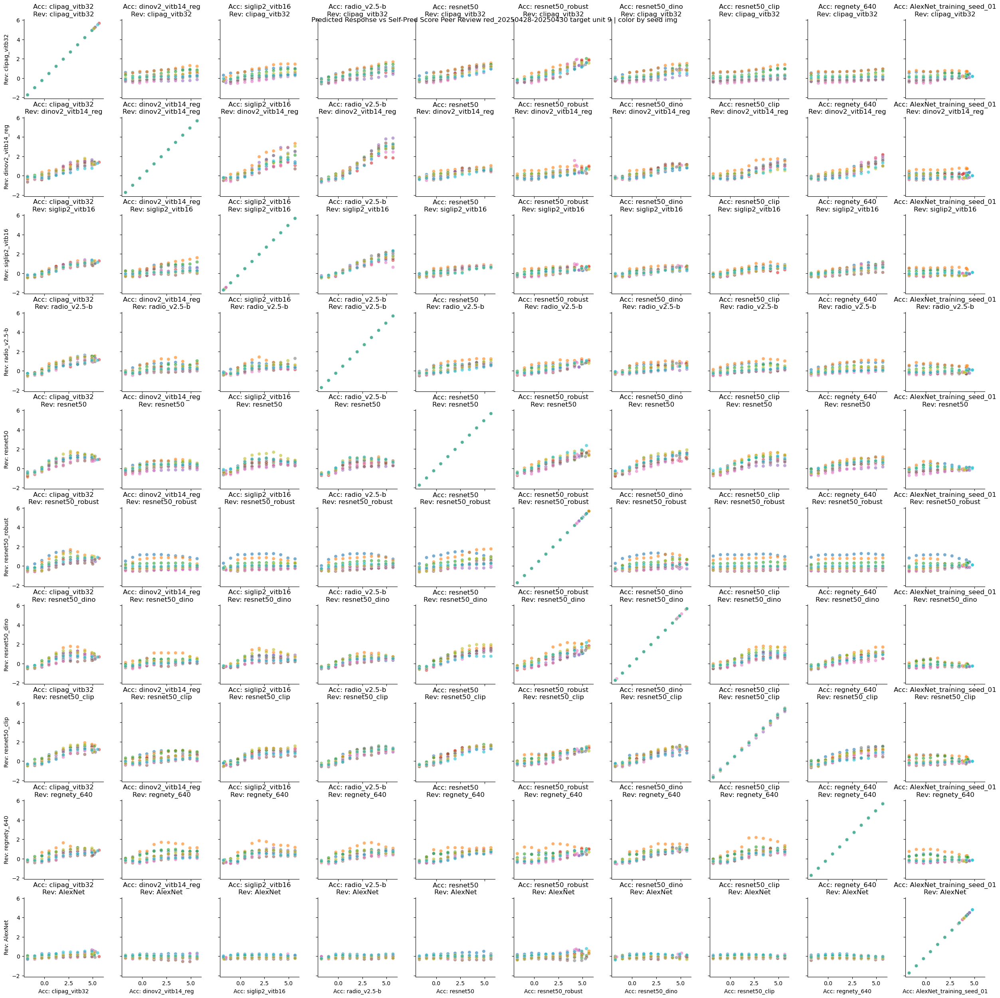

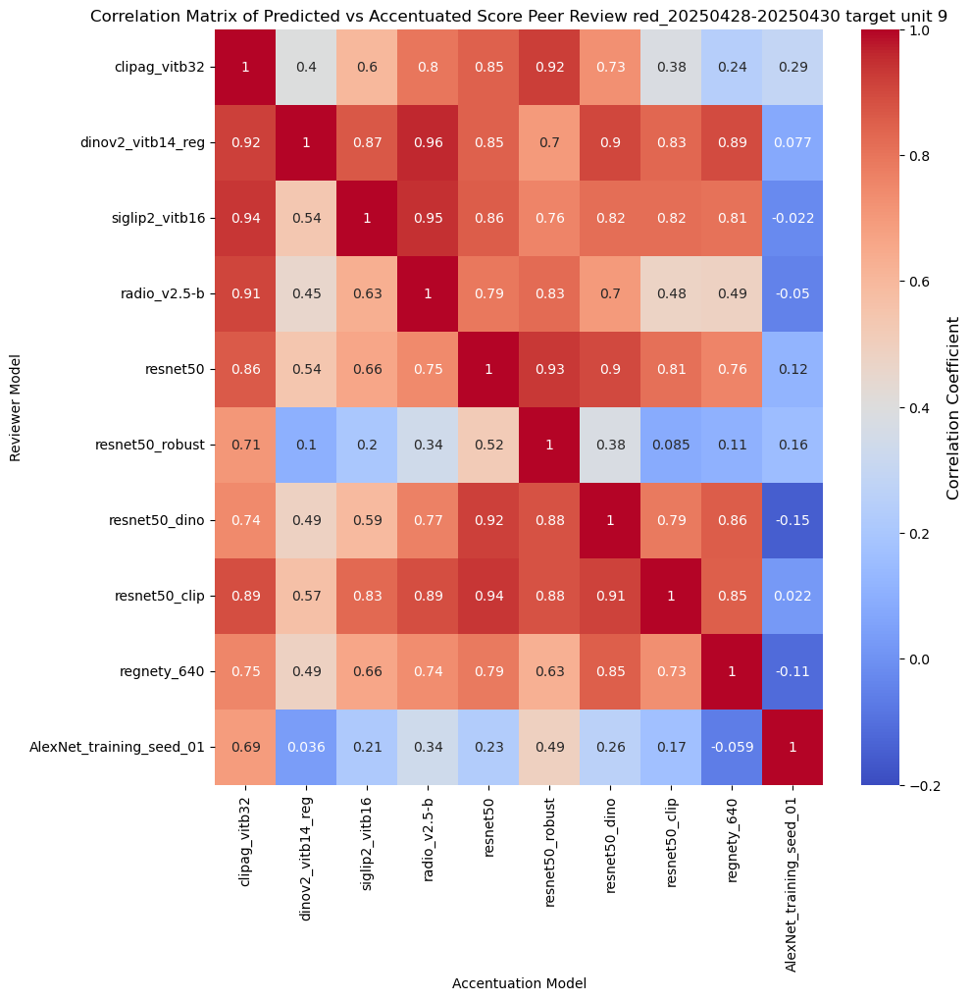

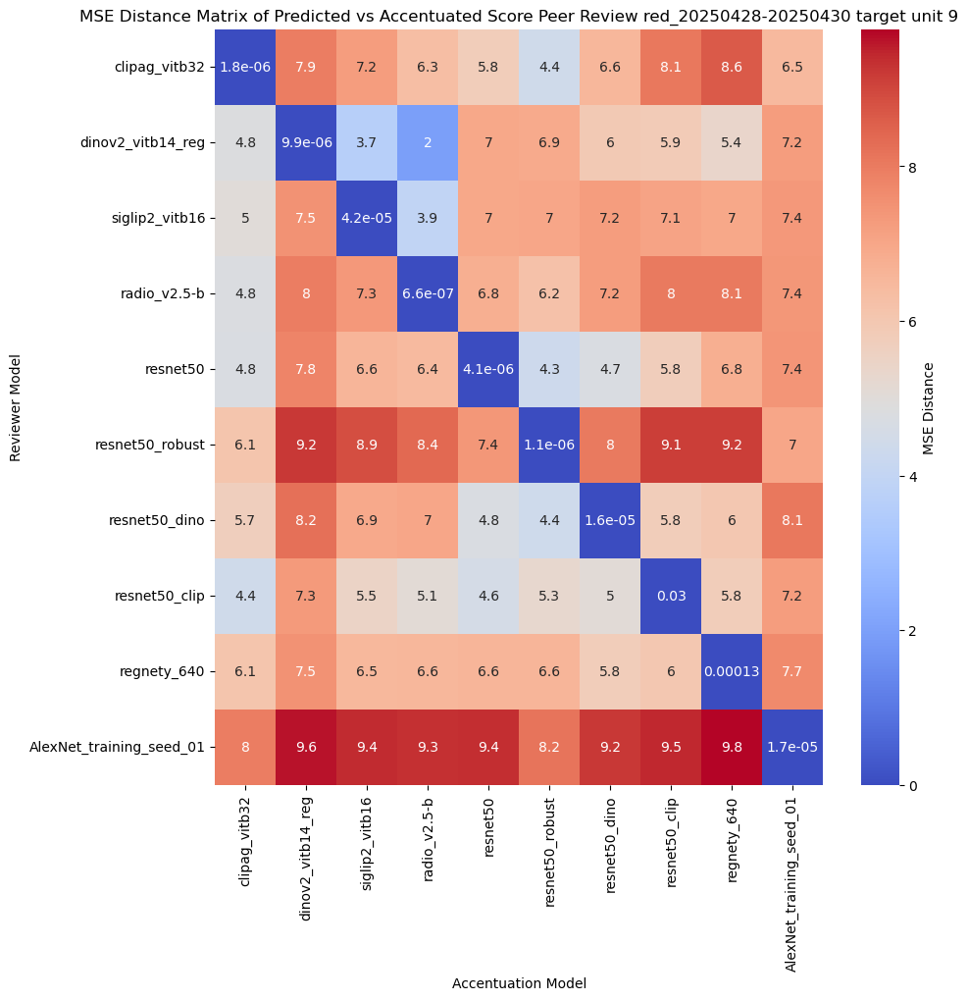

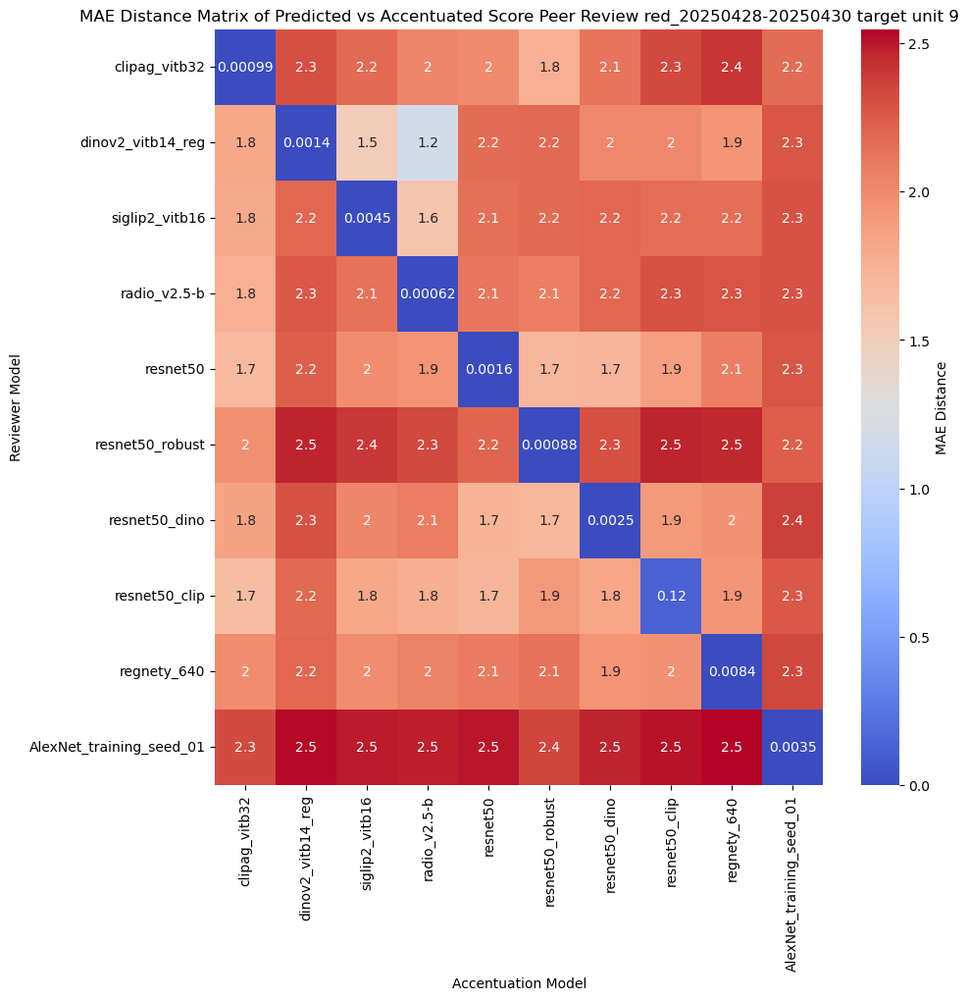

In [38]:
from scipy.stats import pearsonr
for unit_id in df_acc_w_pred_resp['unit_id'].unique():
    figh, axs = plt.subplots(10, 10, figsize=(25, 25), sharex=True, sharey=True)
    for rowi, model_name_rev in enumerate(model_names):
            for coli, model_name_acc in enumerate(model_names):
                sns.scatterplot(data=df_acc_w_pred_resp.query("model_name == @model_name_acc and unit_id == @unit_id"), 
                                x="score", y=f'pred_resp_{model_name_rev}_unit_{unit_id}', 
                                hue="img_id", palette="tab10", alpha=0.6, ax=axs[rowi, coli], legend=False)
                model_name_rev_abv = model_name_rev.replace("AlexNet_training_seed_01", "AlexNet")
                model_name_acc_abv = model_name_acc.replace("AlexNet_training_seed_02", "AlexNet")
                axs[rowi, coli].set_xlabel(f"Acc: {model_name_acc_abv}")
                axs[rowi, coli].set_ylabel(f"Rev: {model_name_rev_abv}")
                axs[rowi, coli].axis('square')
                axs[rowi, coli].set_title(f"Acc: {model_name_acc_abv}\nRev: {model_name_rev_abv}")
    plt.suptitle(f"Predicted Response vs Self-Pred Score Peer Review {subject_id} target unit {unit_id} | color by seed img")
    plt.tight_layout(pad=0.05)
    saveallforms(posthoc_dir, f"{subject_id}_unit_{unit_id}_model_pred_peer_review_all_seeds.png")
    plt.show()

    corr_coef_mat = np.zeros((len(model_names), len(model_names)))
    MSE_dist_mat = np.zeros((len(model_names), len(model_names)))
    MAE_dist_mat = np.zeros((len(model_names), len(model_names)))
    for rowi, model_name_rev in enumerate(model_names):
        for coli, model_name_acc in enumerate(model_names):
            part_df = df_acc_w_pred_resp.query("model_name == @model_name_acc and unit_id == @unit_id")
            MSE_dist = np.mean((part_df["score"] - part_df[f'pred_resp_{model_name_rev}_unit_{unit_id}']) ** 2)
            MSE_dist_mat[rowi, coli] = MSE_dist
            MAE_dist = np.mean(np.abs(part_df["score"] - part_df[f'pred_resp_{model_name_rev}_unit_{unit_id}']))
            MAE_dist_mat[rowi, coli] = MAE_dist
            corr_coef, _ = pearsonr(part_df["score"], part_df[f'pred_resp_{model_name_rev}_unit_{unit_id}'])
            corr_coef_mat[rowi, coli] = corr_coef

    plt.figure(figsize=(10, 10))
    # Create the heatmap and store the returned mappable object
    hm = sns.heatmap(corr_coef_mat, annot=True, cmap="coolwarm", vmin=-0.2, vmax=1, xticklabels=model_names, yticklabels=model_names)
    plt.title(f"Correlation Matrix of Predicted vs Accentuated Score Peer Review {subject_id} target unit {unit_id}")
    plt.ylabel("Reviewer Model")
    plt.xlabel("Accentuation Model")
    # Get the colorbar from the heatmap and set its label
    cbar = hm.collections[0].colorbar
    cbar.set_label("Correlation Coefficient", fontsize=12)
    saveallforms(posthoc_dir, f"{subject_id}_unit_{unit_id}_model_pred_peer_review_corr_coef.png")
    plt.show()

    plt.figure(figsize=(10, 10))
    hm = sns.heatmap(MSE_dist_mat, annot=True, cmap="coolwarm", vmin=0, vmax=None, xticklabels=model_names, yticklabels=model_names)
    plt.title(f"MSE Distance Matrix of Predicted vs Accentuated Score Peer Review {subject_id} target unit {unit_id}")
    plt.ylabel("Reviewer Model")
    plt.xlabel("Accentuation Model")
    # colorbar title
    cbar = hm.collections[0].colorbar
    cbar.set_label("MSE Distance")
    saveallforms(posthoc_dir, f"{subject_id}_unit_{unit_id}_model_pred_peer_review_mse_dist.png")
    plt.show()

    plt.figure(figsize=(10, 10))
    hm = sns.heatmap(MAE_dist_mat, annot=True, cmap="coolwarm", vmin=0, vmax=None, xticklabels=model_names, yticklabels=model_names)
    plt.title(f"MAE Distance Matrix of Predicted vs Accentuated Score Peer Review {subject_id} target unit {unit_id}")
    plt.ylabel("Reviewer Model")
    plt.xlabel("Accentuation Model")
    # colorbar title
    cbar = hm.collections[0].colorbar
    cbar.set_label("MAE Distance")
    saveallforms(posthoc_dir, f"{subject_id}_unit_{unit_id}_model_pred_peer_review_mae_dist.png")
    plt.show()
    plt.close()

In [40]:
posthoc_dir

'/n/holylabs/LABS/alvarez_lab/Lab/VVS_Accentuation/Encoding_models/paul_20250428-20250430/posthoc_model_predict'

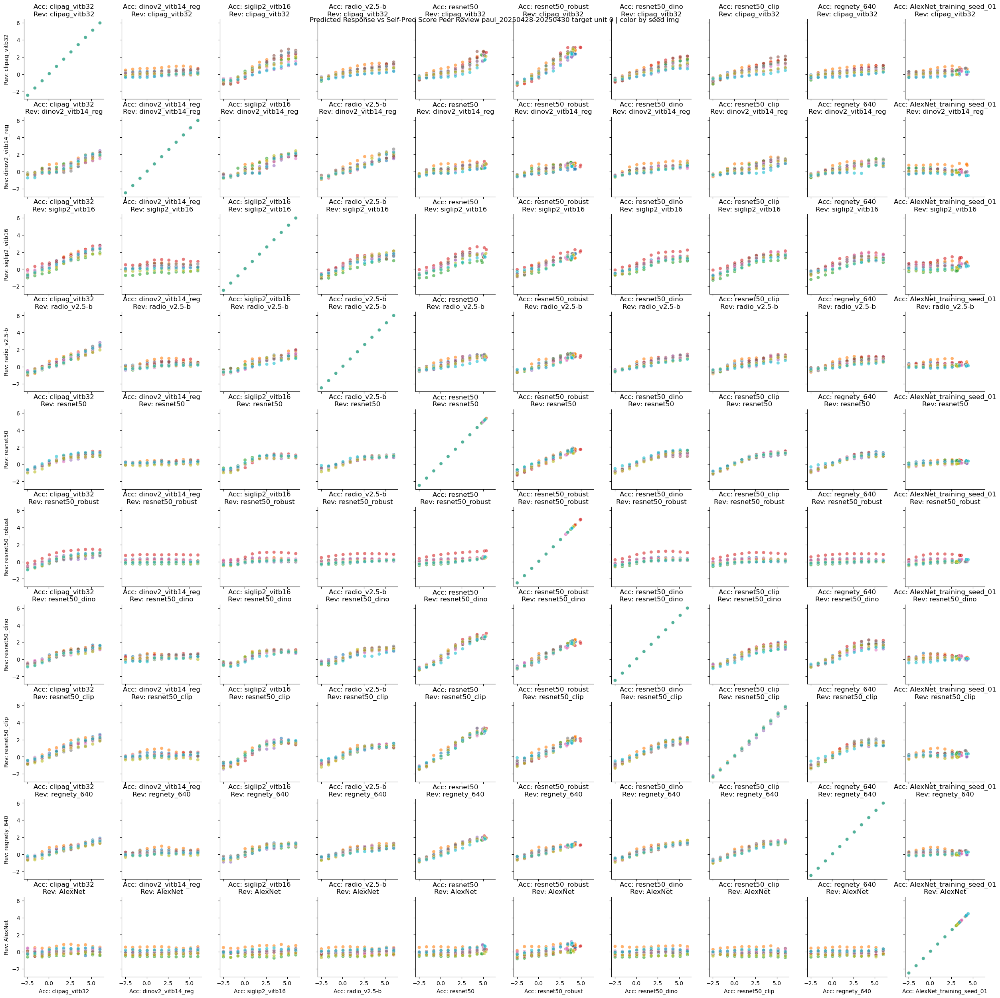

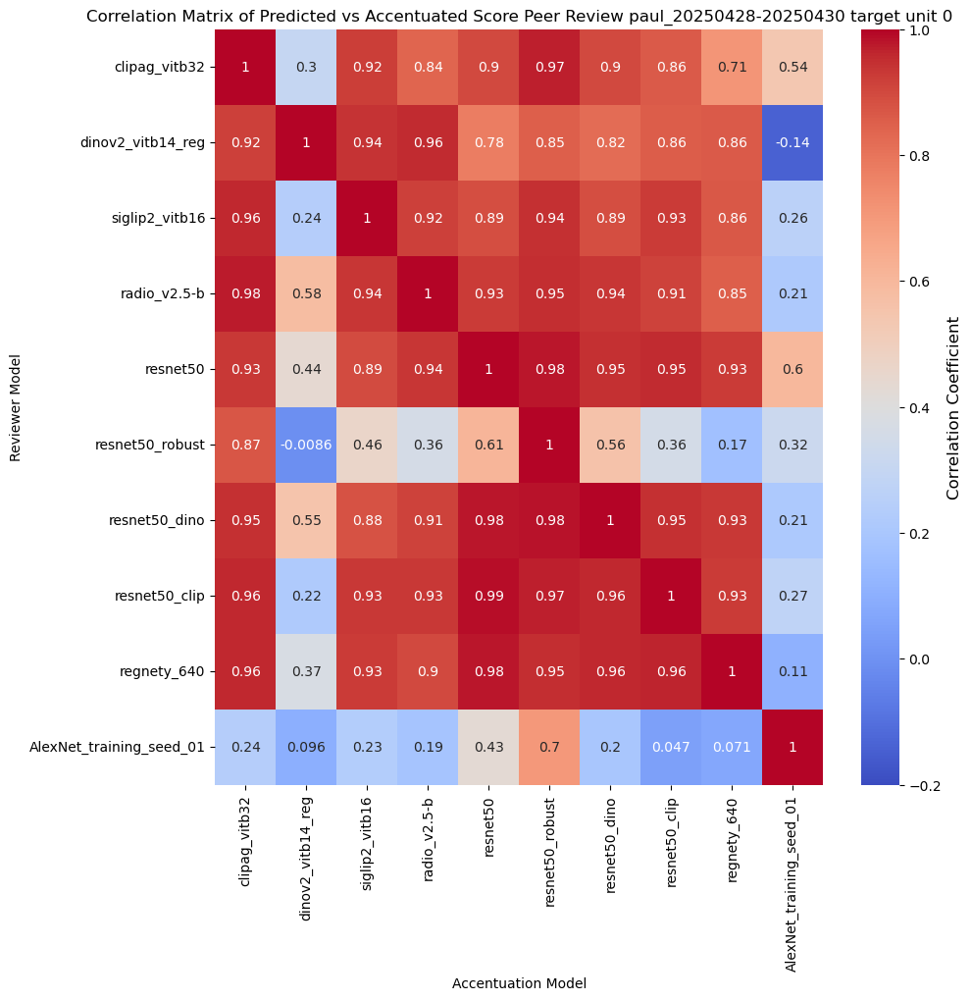

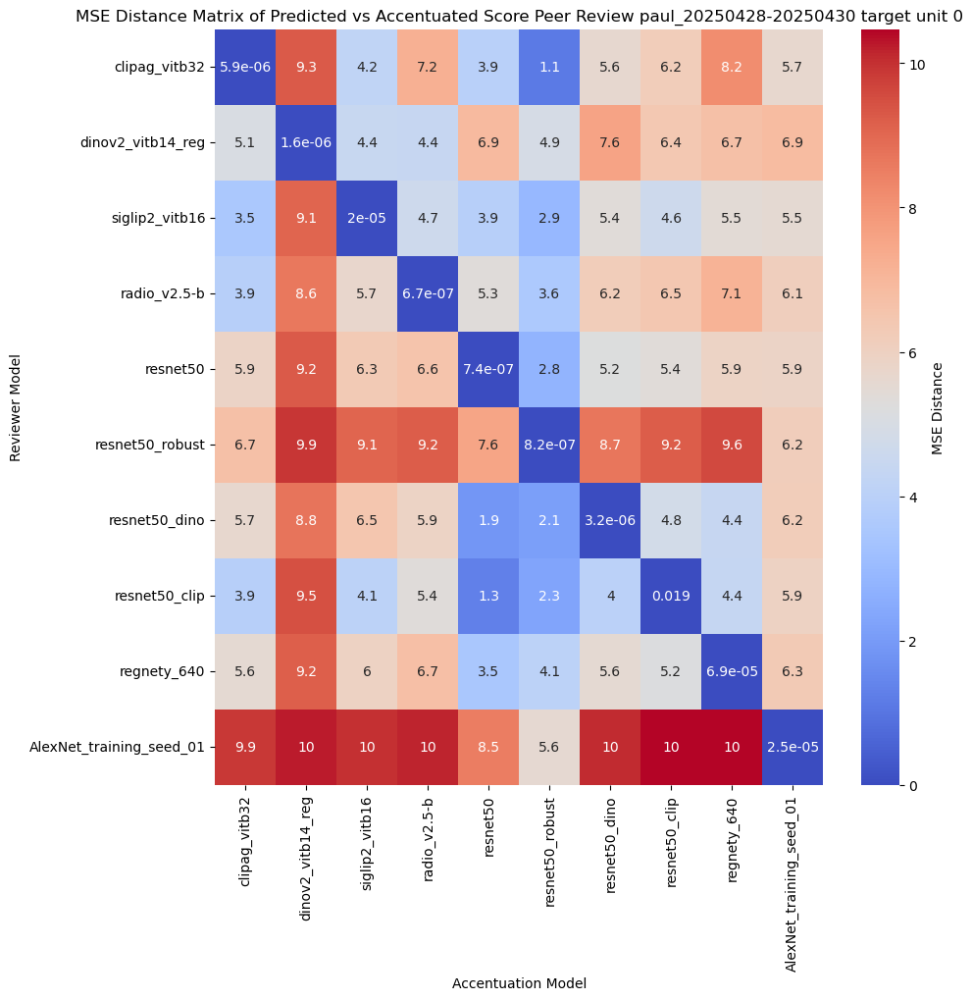

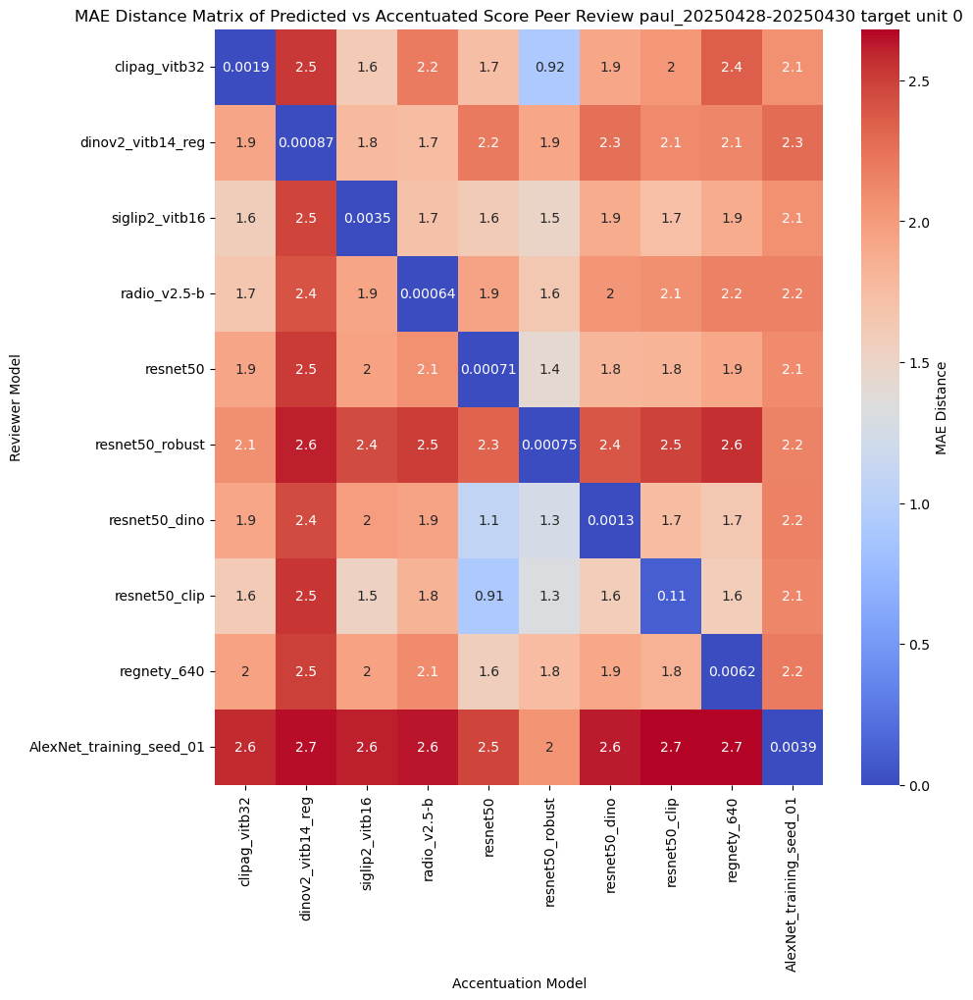

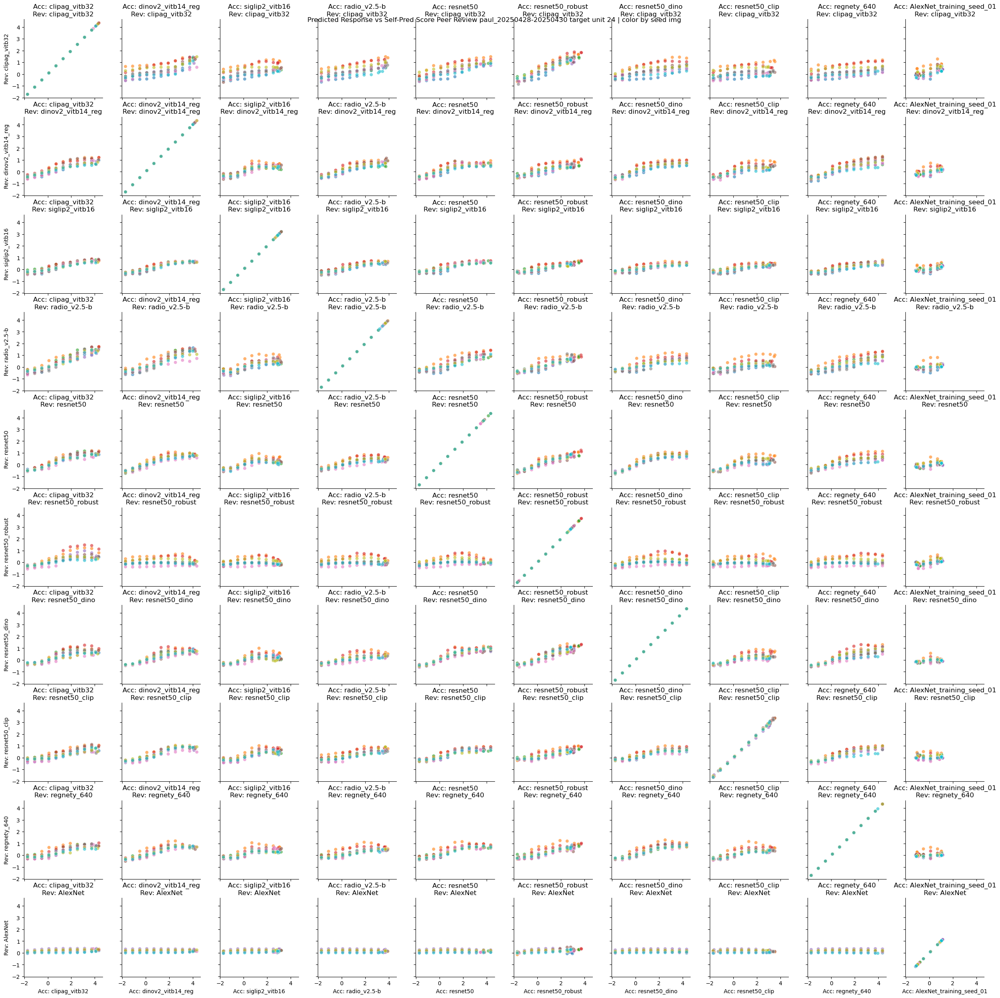

...

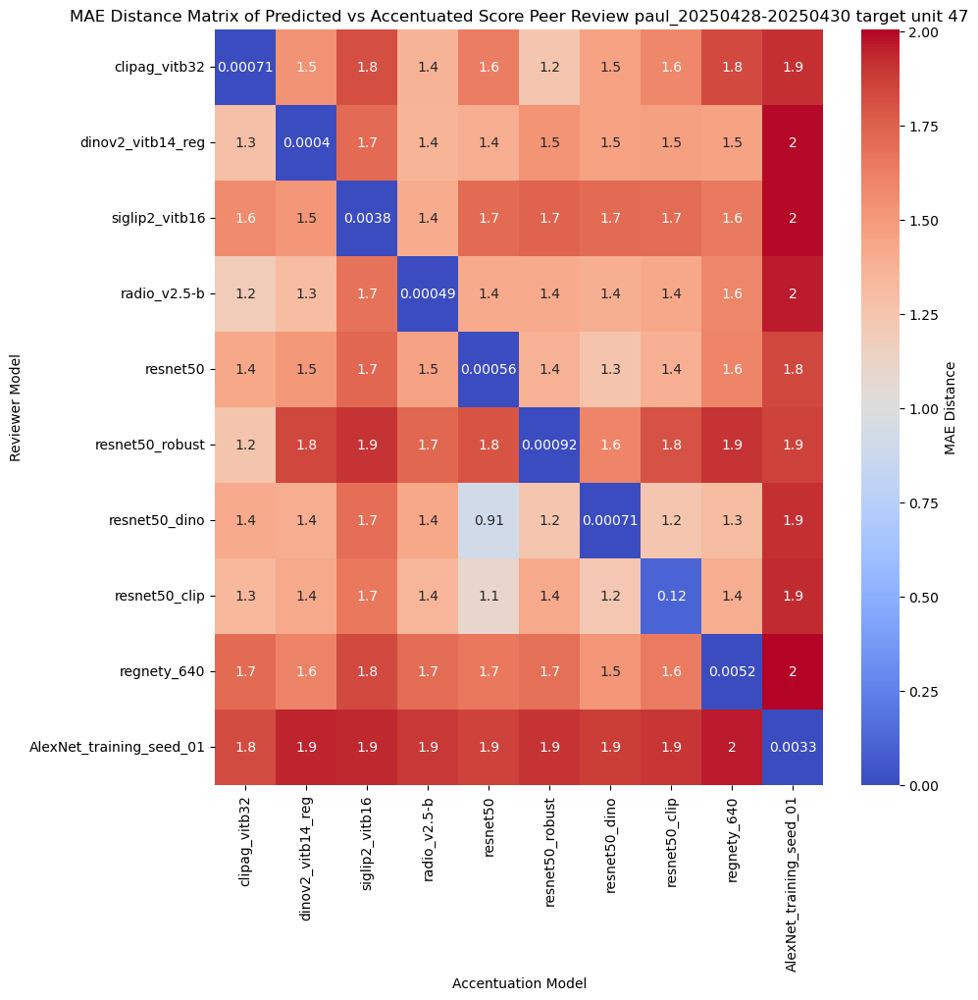

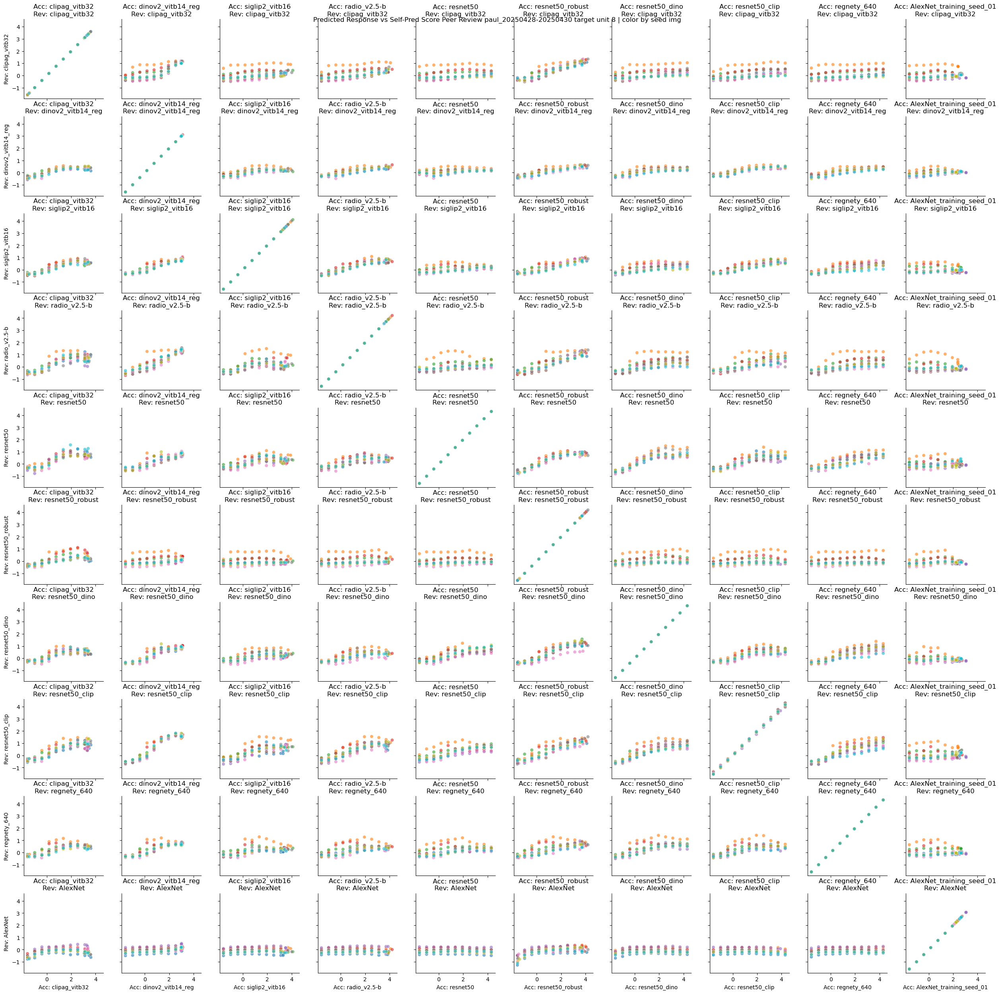

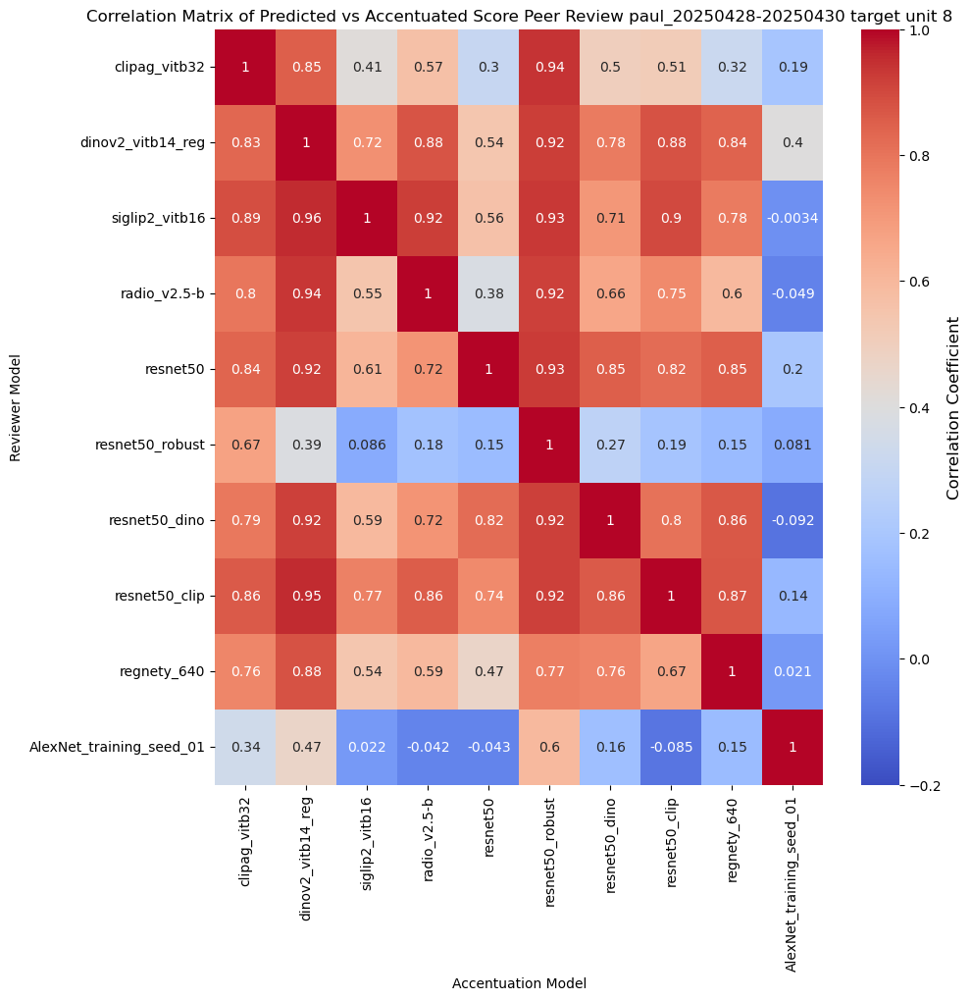

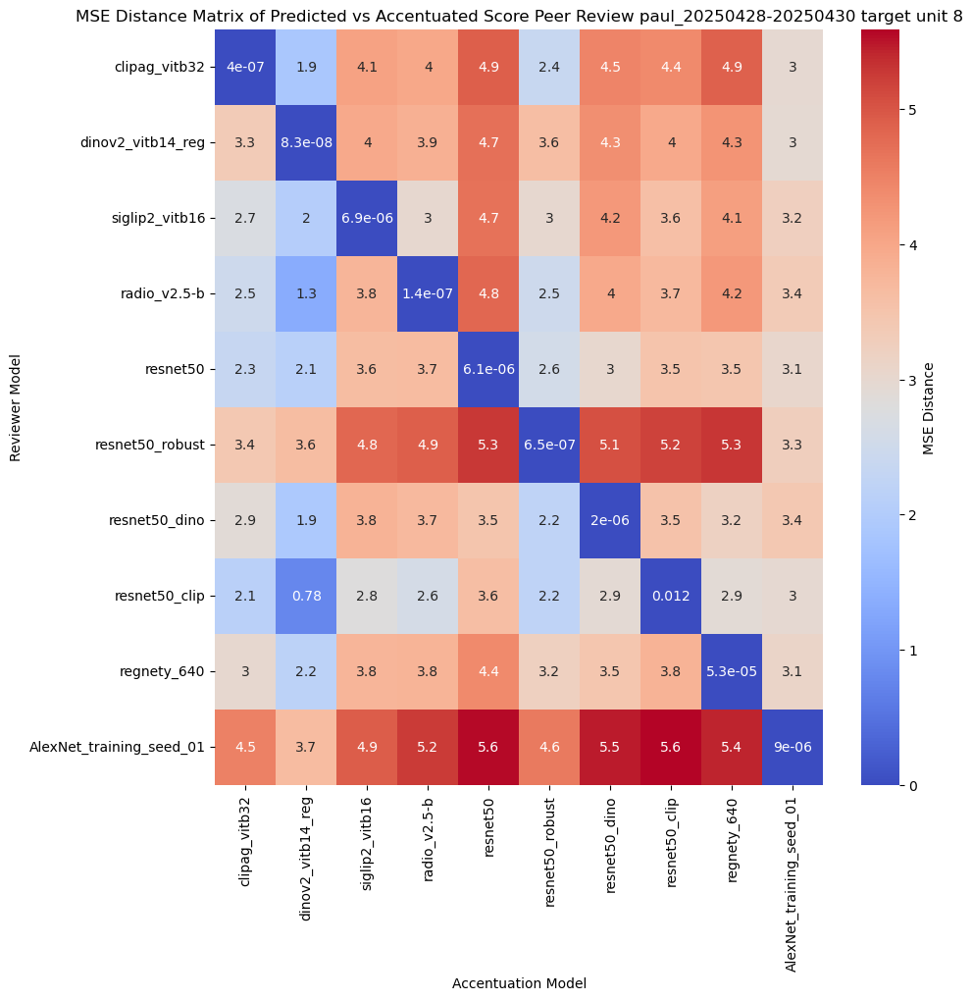

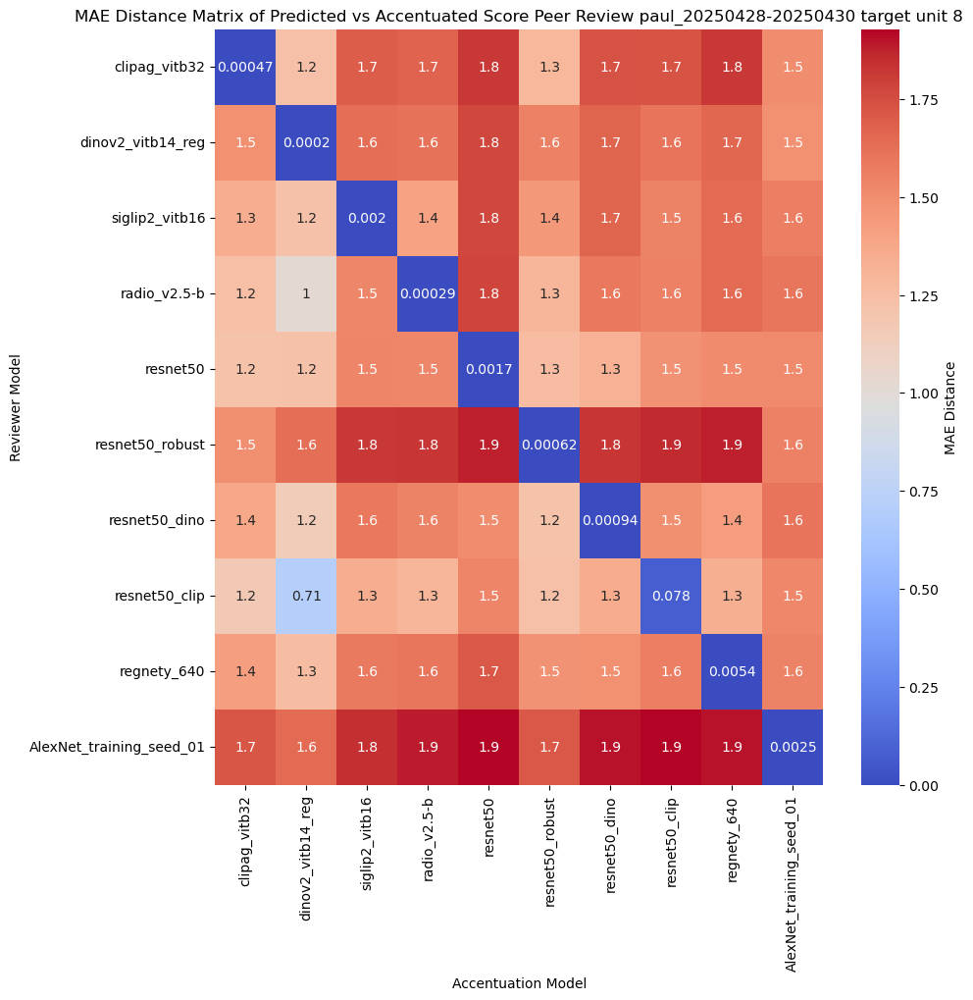

In [39]:
from scipy.stats import pearsonr
subject_id = "paul_20250428-20250430"
# subject_id = "red_20250428-20250430"
posthoc_dir = f"/n/holylabs/LABS/alvarez_lab/Lab/VVS_Accentuation/Encoding_models/{subject_id}/posthoc_model_predict"
os.makedirs(posthoc_dir, exist_ok=True)
df_acc_w_pred_resp = pd.read_pickle(join(posthoc_dir, f"accentuated_stim_info_w_pred_resp_{subject_id}.pkl"))
pred_resp_dict = pkl.load(open(join(posthoc_dir, f"pred_resp_dict_{subject_id}.pkl"), "rb"))
df_accentuated = pd.read_pickle(join(posthoc_dir, f"accentuated_stim_info_{subject_id}.pkl"))

for unit_id in df_acc_w_pred_resp['unit_id'].unique():
    figh, axs = plt.subplots(10, 10, figsize=(25, 25), sharex=True, sharey=True)
    for rowi, model_name_rev in enumerate(model_names):
            for coli, model_name_acc in enumerate(model_names):
                sns.scatterplot(data=df_acc_w_pred_resp.query("model_name == @model_name_acc and unit_id == @unit_id"), 
                                x="score", y=f'pred_resp_{model_name_rev}_unit_{unit_id}', 
                                hue="img_id", palette="tab10", alpha=0.6, ax=axs[rowi, coli], legend=False)
                model_name_rev_abv = model_name_rev.replace("AlexNet_training_seed_01", "AlexNet")
                model_name_acc_abv = model_name_acc.replace("AlexNet_training_seed_02", "AlexNet")
                axs[rowi, coli].set_xlabel(f"Acc: {model_name_acc_abv}")
                axs[rowi, coli].set_ylabel(f"Rev: {model_name_rev_abv}")
                axs[rowi, coli].axis('square')
                axs[rowi, coli].set_title(f"Acc: {model_name_acc_abv}\nRev: {model_name_rev_abv}")
    plt.suptitle(f"Predicted Response vs Self-Pred Score Peer Review {subject_id} target unit {unit_id} | color by seed img")
    plt.tight_layout(pad=0.05)
    saveallforms(posthoc_dir, f"{subject_id}_unit_{unit_id}_model_pred_peer_review_all_seeds.png")
    plt.show()

    corr_coef_mat = np.zeros((len(model_names), len(model_names)))
    MSE_dist_mat = np.zeros((len(model_names), len(model_names)))
    MAE_dist_mat = np.zeros((len(model_names), len(model_names)))
    for rowi, model_name_rev in enumerate(model_names):
        for coli, model_name_acc in enumerate(model_names):
            part_df = df_acc_w_pred_resp.query("model_name == @model_name_acc and unit_id == @unit_id")
            MSE_dist = np.mean((part_df["score"] - part_df[f'pred_resp_{model_name_rev}_unit_{unit_id}']) ** 2)
            MSE_dist_mat[rowi, coli] = MSE_dist
            MAE_dist = np.mean(np.abs(part_df["score"] - part_df[f'pred_resp_{model_name_rev}_unit_{unit_id}']))
            MAE_dist_mat[rowi, coli] = MAE_dist
            corr_coef, _ = pearsonr(part_df["score"], part_df[f'pred_resp_{model_name_rev}_unit_{unit_id}'])
            corr_coef_mat[rowi, coli] = corr_coef

    plt.figure(figsize=(10, 10))
    # Create the heatmap and store the returned mappable object
    hm = sns.heatmap(corr_coef_mat, annot=True, cmap="coolwarm", vmin=-0.2, vmax=1, xticklabels=model_names, yticklabels=model_names)
    plt.title(f"Correlation Matrix of Predicted vs Accentuated Score Peer Review {subject_id} target unit {unit_id}")
    plt.ylabel("Reviewer Model")
    plt.xlabel("Accentuation Model")
    # Get the colorbar from the heatmap and set its label
    cbar = hm.collections[0].colorbar
    cbar.set_label("Correlation Coefficient", fontsize=12)
    saveallforms(posthoc_dir, f"{subject_id}_unit_{unit_id}_model_pred_peer_review_corr_coef.png")
    plt.show()

    plt.figure(figsize=(10, 10))
    hm = sns.heatmap(MSE_dist_mat, annot=True, cmap="coolwarm", vmin=0, vmax=None, xticklabels=model_names, yticklabels=model_names)
    plt.title(f"MSE Distance Matrix of Predicted vs Accentuated Score Peer Review {subject_id} target unit {unit_id}")
    plt.ylabel("Reviewer Model")
    plt.xlabel("Accentuation Model")
    # colorbar title
    cbar = hm.collections[0].colorbar
    cbar.set_label("MSE Distance")
    saveallforms(posthoc_dir, f"{subject_id}_unit_{unit_id}_model_pred_peer_review_mse_dist.png")
    plt.show()

    plt.figure(figsize=(10, 10))
    hm = sns.heatmap(MAE_dist_mat, annot=True, cmap="coolwarm", vmin=0, vmax=None, xticklabels=model_names, yticklabels=model_names)
    plt.title(f"MAE Distance Matrix of Predicted vs Accentuated Score Peer Review {subject_id} target unit {unit_id}")
    plt.ylabel("Reviewer Model")
    plt.xlabel("Accentuation Model")
    # colorbar title
    cbar = hm.collections[0].colorbar
    cbar.set_label("MAE Distance")
    saveallforms(posthoc_dir, f"{subject_id}_unit_{unit_id}_model_pred_peer_review_mae_dist.png")
    plt.show()
    plt.close()